# Setup

In [1]:
%load_ext autoreload
%autoreload 2
from dictionary_learning import CrossCoder
from torch.nn.functional import cosine_similarity
import torch as th
import numpy as np
from pathlib import Path

import plotly.express as px
import plotly.graph_objects as go
from pathlib import Path
from tqdm.notebook import tqdm
import warnings

th.set_grad_enabled(False)
exp_name = "eval_crosscoder"
import sys

sys.path.append("..")

In [4]:
# main_dir = Path(__file__).parent.resolve()

crosscoder = Path("..") / "checkpoints" / "Llama-3.2-1B-L13-k70-lr5e-05-CCLoss" / "checkpoint_90000.pt"
extra_args = []
exp_id = ""
device = "cuda"

In [5]:
from argparse import ArgumentParser
from shutil import rmtree
from tools.utils import load_dictionary_model, model_path_to_name

parser = ArgumentParser()
parser.add_argument("--base-layer", type=int, default=0)
parser.add_argument("--instruct-layer", type=int, default=1)
parser.add_argument("--add-activation-stats", action="store_true")
parser.add_argument("--upload", action="store_true")
parser.add_argument("--overwrite", action="store_true")
args = parser.parse_args(extra_args)
print(args)
base_layer = args.base_layer
instruct_layer = args.instruct_layer
UPLOAD = args.upload
OVERWRITE = args.overwrite

if OVERWRITE:
    print("Overwriting existing results")


if not Path(crosscoder).exists():
    crosscoder_name = "_".join(crosscoder.split("/")[-2:])
else:
    crosscoder_name = model_path_to_name(Path(crosscoder))

coder = load_dictionary_model(crosscoder)
num_layers, activation_dim, dict_size = coder.encoder.weight.shape

save_path = (
    Path("./results") / exp_name / (crosscoder_name + (f"_{exp_id}" if exp_id else ""))
)
save_path_extra = save_path / "extra"
save_path_extra.mkdir(exist_ok=True, parents=True)
save_path_html = save_path / "html"
save_path_html.mkdir(exist_ok=OVERWRITE)
save_path_data = save_path / "data"
save_path_data.mkdir(exist_ok=OVERWRITE)
if device == "auto":
    device = th.device("cuda" if th.cuda.is_available() else "cpu")
else:
    device = th.device(device)
all_info = {}
feature_df = {k: {} for k in range(dict_size)}

Namespace(base_layer=0, instruct_layer=1, add_activation_stats=False, upload=False, overwrite=False)


# Latent analysis on test set

In [6]:
if args.add_activation_stats:
    stats_path = Path(f"../stats/{crosscoder_name}")
    fw_stats = th.load(stats_path / "fineweb.pt").rescaled.joint
    lmsys_stats = th.load(stats_path / "lmsys.pt").rescaled.joint
    fw_deads = (fw_stats.non_zero_counts == 0).cpu()
    fw_avg_activations = (
        fw_stats.avg_activation
        * fw_stats.total_tokens
        / fw_stats.non_zero_counts.float()
    ).cpu()
    fw_freqs = (fw_stats.non_zero_counts.float() / fw_stats.total_tokens).cpu()
    lmsys_deads = (lmsys_stats.non_zero_counts == 0).cpu()
    lmsys_avg_activations = (
        (
            lmsys_stats.avg_activation
            * lmsys_stats.total_tokens
            / lmsys_stats.non_zero_counts.float()
        ).cpu()
    ).cpu()
    lmsys_freqs = (lmsys_stats.non_zero_counts.float() / lmsys_stats.total_tokens).cpu()
    freqs = (
        (fw_stats.non_zero_counts + lmsys_stats.non_zero_counts).float()
        / (fw_stats.total_tokens + lmsys_stats.total_tokens).float()
    ).cpu()
    deads = fw_deads & lmsys_deads
    avg_activations = (
        fw_avg_activations * fw_stats.non_zero_counts.cpu()
        + lmsys_avg_activations * lmsys_stats.non_zero_counts.cpu()
    ).float() / (fw_stats.non_zero_counts + lmsys_stats.non_zero_counts).float().cpu()

    for f_idx, (
        fw_dead,
        fw_freq,
        lmsys_dead,
        lmsys_freq,
        freq,
        dead,
        avg_activation,
        lmsys_avg_activation,
        fw_avg_activation,
    ) in enumerate(
        zip(
            fw_deads,
            fw_freqs,
            lmsys_deads,
            lmsys_freqs,
            freqs,
            deads,
            avg_activations,
            lmsys_avg_activations,
            fw_avg_activations,
        )
    ):
        feature_df[f_idx]["fw_dead"] = fw_dead.item()
        feature_df[f_idx]["fw_freq"] = fw_freq.item()
        feature_df[f_idx]["lmsys_dead"] = lmsys_dead.item()
        feature_df[f_idx]["lmsys_freq"] = lmsys_freq.item()
        feature_df[f_idx]["freq"] = freq.item()
        feature_df[f_idx]["dead"] = dead.item()
        feature_df[f_idx]["avg_activation"] = avg_activation.item()
        feature_df[f_idx]["lmsys_avg_activation"] = lmsys_avg_activation.item()
        feature_df[f_idx]["fw_avg_activation"] = fw_avg_activation.item()

    print(f"frac of dead features: {deads.float().mean().item()}")
    th.save(deads, save_path_data / "deads.pt")
else:
    deads = th.zeros(dict_size, dtype=bool)
alive_mask = ~deads

# Weight analysis

## Compare feature norms

In [8]:
norms = coder.decoder.weight.norm(dim=-1)
norm_diffs = (
    (norms[base_layer] - norms[instruct_layer]) / norms.max(dim=0).values + 1
) / 2
norm_diffs = norm_diffs.cpu()
for f_idx, (base_norm, instruct_norm, norm_diff) in enumerate(
    zip(norms[base_layer], norms[instruct_layer], norm_diffs)
):
    feature_df[f_idx]["dec_base_norm"] = base_norm.item()
    feature_df[f_idx]["dec_instruct_norm"] = instruct_norm.item()
    feature_df[f_idx]["dec_norm_diff"] = norm_diff.item()

# Create color array based on norm difference categories
colors = [
    (
        "green"
        if x <= 0.1
        else "orange" if x >= 0.9 else "blue" if 0.4 <= x <= 0.6 else "grey"
    )
    for x in norm_diffs[alive_mask]
]

# Create masks for each category
it_only_mask = norm_diffs[alive_mask] <= 0.1
base_only_mask = norm_diffs[alive_mask] >= 0.9
shared_mask = (0.4 <= norm_diffs[alive_mask]) & (norm_diffs[alive_mask] <= 0.6)
other_mask = ~(it_only_mask | base_only_mask | shared_mask)

# Create figure
fig = go.Figure()

# Add histogram traces for each category
fig.add_trace(
    go.Histogram(
        x=norm_diffs[alive_mask][it_only_mask],
        name="Chat only",
        marker_color="green",
        nbinsx=50,
    )
)

fig.add_trace(
    go.Histogram(
        x=norm_diffs[alive_mask][base_only_mask],
        name="Base only",
        marker_color="orange",
        nbinsx=50,
    )
)

fig.add_trace(
    go.Histogram(
        x=norm_diffs[alive_mask][shared_mask],
        name="Shared",
        marker_color="blue",
        nbinsx=50,
    )
)

fig.add_trace(
    go.Histogram(
        x=norm_diffs[alive_mask][other_mask],
        name="Other",
        marker_color="grey",
        nbinsx=50,
    )
)

fig.update_layout(
    annotations=[
        dict(
            x=0,
            y=0,
            xref="x",
            yref="paper",
            text="  <b>(Chat only)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
            font=dict(color="green"),
        ),
        dict(
            x=0.5,
            y=0,
            xref="x",
            yref="paper",
            text="    <b>(shared)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
            font=dict(color="blue"),
        ),
        dict(
            x=1,
            y=0,
            xref="x",
            yref="paper",
            text="  <b>(Base only)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
            font=dict(color="orange"),
        ),
    ],
    shapes=[
        dict(
            type="line",
            x0=0.1,
            y0=0,
            x1=0.1,
            y1=1,
            xref="x",
            yref="paper",
            line=dict(color="green", width=2),
        ),
        dict(
            type="line",
            x0=0.9,
            y0=0,
            x1=0.9,
            y1=1,
            xref="x",
            yref="paper",
            line=dict(color="orange", width=2),
        ),
        dict(
            type="line",
            x0=0.4,
            y0=0,
            x1=0.4,
            y1=1,
            xref="x",
            yref="paper",
            line=dict(color="blue", width=2),
        ),
        dict(
            type="line",
            x0=0.6,
            y0=0,
            x1=0.6,
            y1=1,
            xref="x",
            yref="paper",
            line=dict(color="blue", width=2),
        ),
    ],
    showlegend=False,
)
fig.update_xaxes(tickvals=[0, 0.5, 1])
# fig.update_traces(hovertemplate='Feature Index: %{text}<br>Value: %{y}', text=sorted_norm_diffs.indices)
fig.update_xaxes(title="Sorted Features (Highest to Lowest Difference)")
fig.update_yaxes(title="Relative Norm Difference")
fig.update_layout(barmode="stack")
fig.show()
fig.write_html(save_path_html / "decoder_norm_diffs.html")
fig.write_image(save_path / "decoder_norm_diffs.png")

In [9]:
fig = px.histogram(
    x=norm_diffs[deads],
    title="Relative difference in decoder dead feature norms",
    orientation="v",
    nbins=50,
)
fig.update_layout(
    annotations=[
        dict(
            x=0,
            y=0,
            xref="x",
            yref="paper",
            text="  <b>(Chat only)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
        ),
        dict(
            x=0.5,
            y=0,
            xref="x",
            yref="paper",
            text="    <b>(shared)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
        ),
        dict(
            x=1,
            y=0,
            xref="x",
            yref="paper",
            text="  <b>(Base only)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
        ),
    ]
)
fig.update_xaxes(tickvals=[0, 0.5, 1])
# fig.update_traces(hovertemplate='Feature Index: %{text}<br>Value: %{y}', text=sorted_norm_diffs.indices)
fig.update_xaxes(title="Sorted Features (Highest to Lowest Difference)")
fig.update_yaxes(title="Relative Norm Difference")
fig.show()
fig.write_html(save_path_html / "decoder_norm_diffs_dead.html")
fig.write_image(save_path_extra / "decoder_norm_diffs_dead.png")

In [10]:
# save Chat only and base only feature index
treshold = 0.1
only_it_feature_indices = th.nonzero(norm_diffs < treshold, as_tuple=True)[0]
only_base_feature_indices = th.nonzero(norm_diffs > 1 - treshold, as_tuple=True)[0]
shared_feature_indices = th.nonzero((norm_diffs - 0.5).abs() < treshold, as_tuple=True)[
    0
]

th.save(only_it_feature_indices, save_path_data / "only_it_decoder_feature_indices.pt")
th.save(
    only_base_feature_indices, save_path_data / "only_base_decoder_feature_indices.pt"
)
th.save(shared_feature_indices, save_path_data / "shared_decoder_feature_indices.pt")
all_info["frac of dead Chat only features"] = (
    deads[only_it_feature_indices].float().mean().item()
)
all_info["frac of dead base only features"] = (
    deads[only_base_feature_indices].float().mean().item()
)
all_info["frac of dead shared features"] = (
    deads[shared_feature_indices].float().mean().item()
)
is_other_feature = th.ones_like(deads, dtype=bool)
is_other_feature[only_it_feature_indices] = False
is_other_feature[only_base_feature_indices] = False
is_other_feature[shared_feature_indices] = False
all_info["frac of dead other features"] = deads[is_other_feature].float().mean().item()

for f_idx in only_it_feature_indices.tolist():
    feature_df[f_idx]["tag"] = "Chat only"
for f_idx in only_base_feature_indices.tolist():
    feature_df[f_idx]["tag"] = "Base only"
for f_idx in shared_feature_indices.tolist():
    feature_df[f_idx]["tag"] = "Shared"
for f_idx in is_other_feature.nonzero(as_tuple=True)[0].tolist():
    feature_df[f_idx]["tag"] = "Other"

In [11]:
enc_norms = coder.encoder.weight.norm(dim=1)
enc_norm_diffs = (
    (enc_norms[base_layer] - enc_norms[instruct_layer]) / enc_norms.max(dim=0).values
    + 1
) / 2
enc_norm_diffs = enc_norm_diffs.cpu()

for f_idx, (base_norm, instruct_norm, norm_diff) in enumerate(
    zip(enc_norms[base_layer], enc_norms[instruct_layer], enc_norm_diffs)
):
    feature_df[f_idx]["enc_base_norm"] = base_norm.item()
    feature_df[f_idx]["enc_instruct_norm"] = instruct_norm.item()
    feature_df[f_idx]["enc_norm_diff"] = norm_diff.item()

fig = px.histogram(
    x=enc_norm_diffs[alive_mask],
    title="Relative difference in encoder alive feature norms",
    orientation="v",
    nbins=50,
)
fig.update_xaxes(title="Relative Norm Difference")
fig.update_yaxes(title="Count")
fig.update_layout(
    annotations=[
        dict(
            x=0,
            y=0,
            xref="x",
            yref="paper",
            text="<b>(Chat only)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
        ),
        dict(
            x=0.5,
            y=0,
            xref="x",
            yref="paper",
            text="<b>(shared)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
        ),
        dict(
            x=1,
            y=0,
            xref="x",
            yref="paper",
            text="<b>(Base only)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
        ),
    ]
)
fig.show()
fig.write_html(save_path_html / "encoder_norm_diffs.html")
fig.write_image(save_path / "encoder_norm_diffs.png")

In [12]:
enc_norms = coder.encoder.weight.norm(dim=1)
enc_norm_diffs = (
    (enc_norms[base_layer] - enc_norms[instruct_layer]) / enc_norms.max(dim=0).values
    + 1
) / 2

for f_idx, (base_norm, instruct_norm, norm_diff) in enumerate(
    zip(enc_norms[base_layer], enc_norms[instruct_layer], enc_norm_diffs)
):
    feature_df[f_idx]["enc_base_norm"] = base_norm.item()
    feature_df[f_idx]["enc_instruct_norm"] = instruct_norm.item()
    feature_df[f_idx]["enc_norm_diff"] = norm_diff.item()

fig = px.histogram(
    x=enc_norm_diffs[deads],
    title="Relative difference in encoder dead feature norms",
    orientation="v",
    nbins=50,
)
fig.update_xaxes(title="Relative Norm Difference")
fig.update_yaxes(title="Count")
fig.update_layout(
    annotations=[
        dict(
            x=0,
            y=0,
            xref="x",
            yref="paper",
            text="<b>(Chat only)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
        ),
        dict(
            x=0.5,
            y=0,
            xref="x",
            yref="paper",
            text="<b>(shared)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
        ),
        dict(
            x=1,
            y=0,
            xref="x",
            yref="paper",
            text="<b>(Base only)</b>",
            showarrow=False,
            yanchor="top",
            xanchor="left",
        ),
    ]
)
fig.show()
fig.write_html(save_path_html / "encoder_norm_diffs_dead.html")
fig.write_image(save_path_extra / "encoder_norm_diffs_dead.png")

## Cosine similarity

### Decoder

In [13]:
decoder_cos_sims = cosine_similarity(
    coder.decoder.weight[base_layer], coder.decoder.weight[instruct_layer], dim=1
)
for f_idx, cos_sim in enumerate(decoder_cos_sims):
    feature_df[f_idx]["dec_cos_sim"] = cos_sim.item()

decoder_cos_sims_sorted = decoder_cos_sims.sort(descending=True)

# Calculate mean cosine similarity between random latent vectors
num_samples = 10000
random_idx = th.randint(0, coder.decoder.weight.shape[1], (num_samples, 2))
random_cos_sims = cosine_similarity(
    coder.decoder.weight[base_layer][random_idx[:, 0]],
    coder.decoder.weight[instruct_layer][random_idx[:, 1]],
    dim=1,
)
mean_random_cos_sim = random_cos_sims.mean().item()

In [14]:
fig = px.histogram(
    x=decoder_cos_sims[alive_mask].cpu(),
    title="Cosine similarity between decoder alive feature vectors",
    orientation="v",
    nbins=50,
)
fig.update_xaxes(title="Cosine Similarity")
fig.update_yaxes(title="Count")
fig.add_vline(
    x=mean_random_cos_sim,
    line_dash="dash",
    line_color="red",
    annotation_text=f"Mean Random Cosine Similarity: {mean_random_cos_sim:.4f}",
)
fig.show()
fig.write_html(save_path_html / "decoder_cos_sims.html")
fig.write_image(save_path / "decoder_cos_sims.png")

In [15]:
import pandas as pd

df = pd.DataFrame(feature_df).T

filtered_decoder_cos_sims = decoder_cos_sims[alive_mask].cpu()
filtered_tags = df["tag"][alive_mask.cpu().numpy()]

# Normalize by amount of each tag that are not dead
tag_counts = filtered_tags.value_counts()

# Create histogram with normalized counts
fig = px.histogram(
    x=filtered_decoder_cos_sims,
    title="Cosine similarity between decoder feature vectors (Alive)",
    orientation="v",
    nbins=50,
    color=filtered_tags,
    color_discrete_map={
        "Shared": "blue",
        "Base only": "orange",
        "Chat only": "green",
        "Other": "grey",
    },
    # Normalize histogram counts by tag frequency
    histnorm="probability",
    # Group by tag to normalize each category separately
    barmode="group",
)

fig.update_xaxes(title="Cosine Similarity")
fig.update_yaxes(title="Normalized Count", range=[0, 1])
fig.add_vline(
    x=mean_random_cos_sim,
    line_dash="dash",
    line_color="red",
    annotation_text=f"Mean Random Cosine Similarity: {mean_random_cos_sim:.4f}",
)
fig.show()
fig.write_html(save_path_html / "decoder_cos_sims_colored.html")
fig.write_image(save_path / "decoder_cos_sims_colored.png")

In [16]:
fig = px.histogram(
    x=decoder_cos_sims[deads],
    title="Cosine similarity between decoder dead feature vectors",
    orientation="v",
    nbins=50,
)
fig.update_xaxes(title="Cosine Similarity")
fig.update_yaxes(title="Count")
fig.add_vline(
    x=mean_random_cos_sim,
    line_dash="dash",
    line_color="red",
    annotation_text=f"Mean Random Cosine Similarity: {mean_random_cos_sim:.4f}",
)
fig.show()
fig.write_html(save_path_html / "decoder_cos_sims_dead.html")
fig.write_image(save_path_extra / "decoder_cos_sims_dead.png")

### Encoder

In [17]:
encoder_cos_sims = cosine_similarity(
    coder.encoder.weight[base_layer], coder.encoder.weight[instruct_layer], dim=0
)
for f_idx, cos_sim in enumerate(encoder_cos_sims):
    feature_df[f_idx]["enc_cos_sim"] = cos_sim.item()

mean_random_cos_sim_encoder = (
    cosine_similarity(
        coder.encoder.weight[base_layer][:, random_idx[:, 0]],
        coder.encoder.weight[instruct_layer][:, random_idx[:, 1]],
        dim=0,
    )
    .mean()
    .item()
)

In [18]:
fig = px.histogram(
    x=encoder_cos_sims[alive_mask].cpu(),
    title="Cosine similarity between encoder alive feature vectors",
    orientation="v",
    nbins=50,
)
fig.update_xaxes(title="Cosine Similarity")
fig.update_yaxes(title="Count")
fig.add_vline(
    x=mean_random_cos_sim_encoder,
    line_dash="dash",
    line_color="red",
    annotation_text=f"Mean Random Cosine Similarity: {mean_random_cos_sim_encoder:.4f}",
)
fig.show()
fig.write_html(save_path_html / "encoder_cos_sims.html")
fig.write_image(save_path / "encoder_cos_sims.png")

In [19]:
fig = px.histogram(
    x=encoder_cos_sims[deads],
    title="Cosine similarity between encoder dead feature vectors",
    orientation="v",
    nbins=50,
)
fig.update_xaxes(title="Cosine Similarity")
fig.update_yaxes(title="Count")
fig.add_vline(
    x=mean_random_cos_sim_encoder,
    line_dash="dash",
    line_color="red",
    annotation_text=f"Mean Random Cosine Similarity: {mean_random_cos_sim_encoder:.4f}",
)
fig.show()
fig.write_html(save_path_html / "encoder_cos_sims_dead.html")
fig.write_image(save_path_extra / "encoder_cos_sims_dead.png")

# End

In [20]:
import pandas as pd
import json

pd.DataFrame(feature_df).T.to_csv(save_path_data / "feature_df.csv")
with open(save_path_data / "all_info.json", "w") as f:
    json.dump(all_info, f)

In [21]:
df = pd.DataFrame(feature_df).T
if args.add_activation_stats:
    display(df.sort_values(by="freq", ascending=False))
else:
    display(df.sort_values(by="dec_norm_diff", ascending=True))

,dec_base_norm,dec_instruct_norm,dec_norm_diff,tag,enc_base_norm,enc_instruct_norm,enc_norm_diff,dec_cos_sim,enc_cos_sim
15512,0.237154,1.003781,0.11813,Other,1.101038,1.334151,0.412636,-0.083374,-0.118635
8766,0.255009,0.986144,0.129296,Other,1.223114,1.410638,0.433532,0.198585,-0.119953
9657,0.295978,1.009243,0.146634,Other,1.41653,1.543539,0.458858,-0.360979,-0.132715
15432,0.302328,0.915149,0.16518,Other,1.402784,1.618339,0.433402,0.286331,-0.024365
14947,0.328538,0.99145,0.165686,Other,1.106094,1.277164,0.433027,-0.027037,-0.281557
...,...,...,...,...,...,...,...,...,...
5206,0.209323,0.03816,0.90885,Base only,1.139777,0.911505,0.600139,0.669401,-0.22981
9378,0.209828,0.037877,0.909742,Base only,1.156268,0.917356,0.603312,0.663426,-0.220841
2048,0.206862,0.03711,0.910303,Base only,1.107159,0.864581,0.60955,0.590536,-0.157419
10835,0.210697,0.036098,0.914338,Base only,1.225645,0.930917,0.620234,0.64864,-0.19614


# Additional Analysis

In [ ]:
import sys
sys.path.append("..")
import plotly.express as px

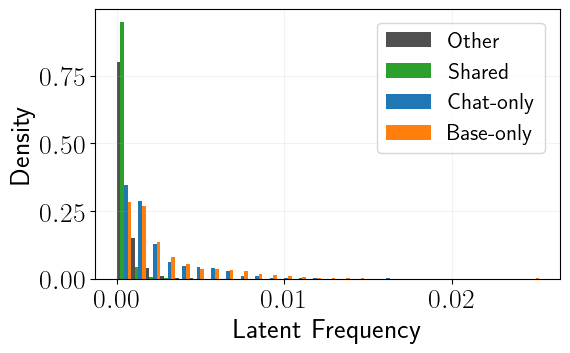

In [57]:
if "freq" in df.columns:
    import numpy as np
    import matplotlib.pyplot as plt

    # Get unique tags for grouping
    tags = df['tag'].unique()

    # Create figure
    fig = plt.figure(figsize=(6, 3.5))
    ax = fig.add_subplot(111)

    # Colors matching the other plot
    colors = {'IT only': 'C0', 'Base only': 'C1', 'Shared': 'C2', 'Other': '#505050'}

    # First determine global bin edges
    all_freqs = np.concatenate([df[df['tag'] == tag]['freq'] for tag in tags])
    bins = np.linspace(min(all_freqs), max(all_freqs), 30)
    bin_width = bins[1] - bins[0]

    # Calculate bar width and offsets
    n_tags = len(tags)
    single_bar_width = bin_width / (n_tags )  # Add 1 for spacing
    offsets = np.linspace(-bin_width/2 + single_bar_width/2, 
                        bin_width/2 - single_bar_width/2, 
                        n_tags)

    # Plot histogram for each tag
    for tag, offset in zip(tags, offsets):
        tag_data = df[df['tag'] == tag]
        counts, _ = np.histogram(tag_data['freq'], bins=bins)
        normalized_counts = counts / counts.sum()
        bin_centers = (bins[:-1] + bins[1:]) / 2
        
        ax.bar(bin_centers + offset, normalized_counts, 
            width=single_bar_width,
            alpha=1.,
            label=tag.replace("IT only", "Chat-only").replace("Base only", "Base-only"),
            color=colors[tag])

    # Styling
    plt.rcParams['text.usetex'] = True
    plt.rcParams.update({'font.size': 20})

    ax.grid(True, alpha=0.15)
    ax.set_xlabel("Latent Frequency")
    ax.set_ylabel("Density")

    # Move legend below plot
    ax.legend(fontsize=16, bbox_to_anchor=(0.99, 0.99))

    plt.savefig("latent_frequency_histogram.pdf", bbox_inches='tight')
    plt.show()

# Upload

In [ ]:
# UPLOAD = True
if UPLOAD:
    from tools.cc_utils import push_dictionary_model, push_latent_df
    
    if Path(crosscoder).exists():
        print(f"Pushing local model {crosscoder} to the hub")
        model_repo_id = push_dictionary_model(model_path=Path(crosscoder))
        print(f"Model repo ID: {model_repo_id}")
        
    df_repo_id = push_latent_df(df=df, crosscoder=crosscoder_name, create_repo_if_missing=True, confirm=False)
    print(f"DF repo ID: {df_repo_id}")


Pushing local model ../checkpoints/Llama-3.2-1B-L13-k70-lr5e-05-CCLoss/checkpoint_90000.pt to the hub
Error uploading model to hub: (Request ID: Root=1-6814ed6b-06ba19fa1eb6dcc80bc96d9d;db7a300e-0b4a-46f4-b53f-efb4073da434)

403 Forbidden: You don't have the rights to create a model under the namespace "science-of-finetuning".
Cannot access content at: https://huggingface.co/api/repos/create.
Make sure your token has the correct permissions.
Repository science-of-finetuning/Llama-3.2-1B-L13-k70-lr5e-05-CCLoss doesn't exist. Creating it...
Failed to create repository and upload model: (Request ID: Root=1-6814ed6c-1cba25f44e9bda7c1b2bbd5c;118387f2-c381-458e-9edb-24178cdf6634)

403 Forbidden: You don't have the rights to create a model under the namespace "science-of-finetuning".
Cannot access content at: https://huggingface.co/api/repos/create.
Make sure your token has the correct permissions.


HfHubHTTPError: (Request ID: Root=1-6814ed6c-1cba25f44e9bda7c1b2bbd5c;118387f2-c381-458e-9edb-24178cdf6634)

403 Forbidden: You don't have the rights to create a model under the namespace "science-of-finetuning".
Cannot access content at: https://huggingface.co/api/repos/create.
Make sure your token has the correct permissions.